# Denoising
In this notebook we will show the use of the denoising algorithm. We asume that the dicom image are already converted to images like is show in the notebook [dicom_conversion](dicom_conversion.ipynb).

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import cv2
import imageio

from IPython.display import Image
from models.archs.kbnet_s_arch import KBNet_s
from metrics import mse, psnr

# Denoising 1 sample
First we will start by denoising 1 sample image

In [32]:
image_localtion = r"demo\source_images\needle0.png"
image = cv2.imread(image_localtion, 0)

image_np = np.array(image)
image_np = image_np / np.max(image_np)

noisy_image = image_np + np.random.normal(0, 0.1, image_np.shape)

In order to denoise the image we need to import the model

In [23]:
model = KBNet_s(img_channel=1)
model = nn.DataParallel(model)
model.eval()

weights = torch.load("models\pretrained\gau_gray_25.pth")
model.load_state_dict(weights["net"])


<All keys matched successfully>

With the model we can denoise the image

In [33]:
noisy_image = torch.from_numpy(noisy_image).unsqueeze(0).unsqueeze(0).float()

with torch.no_grad():
    denoised_image = model(noisy_image)

noisy_image = noisy_image.squeeze().squeeze().numpy()
denoised_image = denoised_image.squeeze().squeeze().numpy()

Finally we can plot the image, noised image and the denoised image

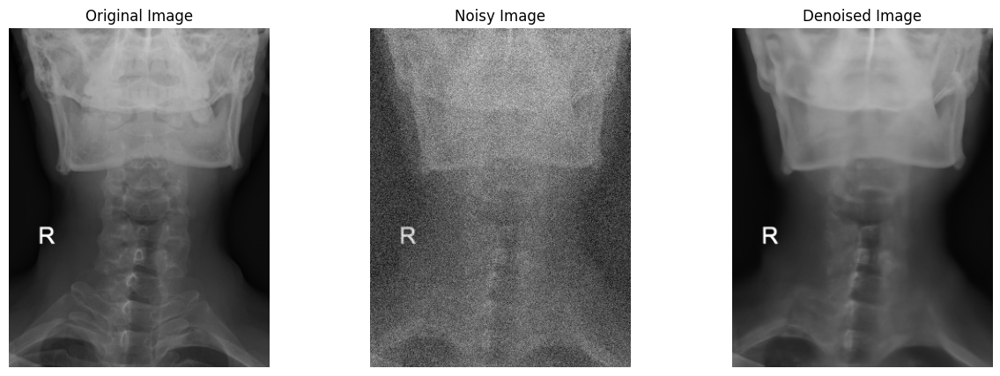

In [34]:
# plot original image, noise image and denoised image
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
# turn off axis
for ax in axs:
    ax.axis("off")
    
axs[0].imshow(image, cmap="gray")
axs[0].set_title("Original Image")
axs[1].imshow(noisy_image, cmap="gray")
axs[1].set_title("Noisy Image")
axs[2].imshow(denoised_image, cmap="gray")
axs[2].set_title("Denoised Image")
plt.show()

Finally calculate the metrics

In [69]:
mse_value = mse(image_np, denoised_image)
psnr_value = psnr(image_np, denoised_image)
print("MSE: {:.4f}".format(mse_value))
print("PSNR: {:.4f}".format(psnr_value))

MSE: 0.0002
PSNR: 84.5288


# Denoise multiple images in order to simulate a video

In order to simulate a 24 fps video we will denoise 120 images to simulate a video of 5 seconds, in the frames a virtual "needle" is a added which moves and simulate the movement of a real needle in a surgery.

In [16]:
SOURCE_IMAGES = r"demo\source_images"
NOISED_IMAGES = r"demo\noised_images"
DENOISED_IMAGES = r"demo\denoised_images"
GIF_LOCATION = r"demo\gifs"

First, we load the images

In [11]:
images = []
for file in os.listdir(SOURCE_IMAGES):
    img = cv2.imread(os.path.join(SOURCE_IMAGES, file), 0)
    # convert to numpy array
    img = np.array(img)
    # normalize
    img = img / np.max(img)
    images.append(img)

We also create a gif to visualize the video

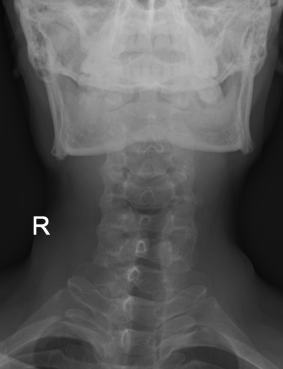

In [24]:
images_gif = np.array(images) * 255
img_gif = []
for img in images_gif:
    img = img.astype(np.uint8)
    img_gif.append(img)

imageio.mimsave(os.path.join(GIF_LOCATION, "original.gif"), img_gif, fps=24)

Image(filename=os.path.join(GIF_LOCATION, "original.gif"))


Then, we add noise and save the images 

In [37]:
noisy_images = []
for img in images:
    noisy_img = img + np.random.normal(0, 0.1, img.shape)
    noisy_images.append(noisy_img)
    
os.makedirs(NOISED_IMAGES, exist_ok=True)
for i, img in enumerate(noisy_images):
    cv2.imwrite(os.path.join(NOISED_IMAGES, "noised_{}.png".format(i)), img * 255)
    

We denoise the images and save them

In [51]:
denoised_images = []
for i in range(len(noisy_images)):
    # convert to torch tensor
    noisy_img = torch.from_numpy(noisy_images[i]).unsqueeze(0).unsqueeze(0).float()

    # run the model
    with torch.no_grad():
        denoised_img = model(noisy_img)

    # convert to numpy array
    denoised_img = denoised_img.squeeze().squeeze().numpy()
    denoised_images.append(denoised_img)

os.makedirs(DENOISED_IMAGES, exist_ok=True)
for i, img in enumerate(denoised_images):
    cv2.imwrite(os.path.join(DENOISED_IMAGES, "denoised_{}.png".format(i)), img * 255)


We make a gif with the denoised images

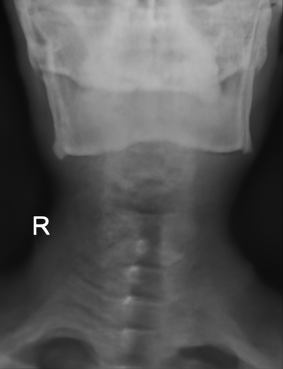

In [59]:
images_gif = np.array(denoised_images) * 255
img_gif = []
for img in images_gif:
    img = img.astype(np.uint8)
    img_gif.append(img)

imageio.mimsave(os.path.join(GIF_LOCATION, "denoised.gif"), img_gif, fps=24)

Image(filename=os.path.join(GIF_LOCATION, "denoised.gif"))

Finally we can calculate the average metrics over the 120 images

In [74]:
mse_values = []
for img, denoised_img in zip(images, denoised_images):
    mse_value = mse(img, denoised_img)
    mse_values.append(mse_value)

psnr_values = []
for img, denoised_img in zip(images, denoised_images):
    psnr_value = psnr(img, denoised_img)
    psnr_values.append(psnr_value)

print("MSE: {:.4f}".format(np.mean(mse_values)))
print("PSNR: {:.4f}".format(np.mean(psnr_values)))

MSE: 0.0002
PSNR: 84.4927


# Improving denoising by using 3 layer input

In order to extract more information from the images we can use the 3 layer input denoising, in this method we will stack 3 gray scale images in order to create a 3 layer input image, this will allow the model to also extract some temporal information from the images.


In [53]:
stacked_images = []
for i in range(len(noisy_images) - 2):
    stacked_image = np.stack(
        (noisy_images[i], noisy_images[i + 1], noisy_images[i + 2]), axis=2
    )
    stacked_images.append(stacked_image)

We need to reload the model with the 3 layer input and according weights

In [56]:
model = KBNet_s(img_channel=3)
model = nn.DataParallel(model)
model.eval()

weights = torch.load("models\pretrained\gau_color_25.pth")
model.load_state_dict(weights["net"])

<All keys matched successfully>

Because everything is already loaded we can directly run inference on the stacked images

In [54]:
DENOISED_STACKED_IMAGES = r"demo\denoised_stacked_images"

In [57]:
denoised_images_stacked = []
for img in stacked_images:
    img = torch.from_numpy(img)
    img = img.unsqueeze(0)
    img = img.permute(0, 3, 1, 2)
    img = img.float()
    denoised_img = model(img)
    denoised_img = denoised_img.squeeze(0)
    denoised_img = denoised_img.permute(1, 2, 0)
    denoised_img = denoised_img.detach().numpy()
    denoised_images_stacked.append(denoised_img)

os.makedirs(DENOISED_STACKED_IMAGES, exist_ok=True)
for i, img in enumerate(denoised_images_stacked):
    cv2.imwrite(
        os.path.join(DENOISED_STACKED_IMAGES, "denoised_{}.png".format(i)), img * 255
    )

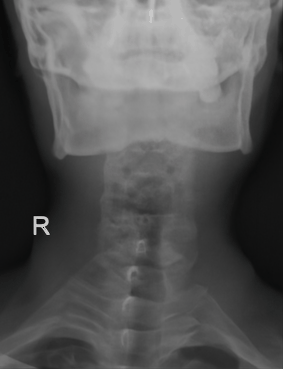

In [60]:
images_gif = np.array(denoised_images_stacked) * 255
img_gif = []
for img in images_gif:
    img = img.astype(np.uint8)
    img_gif.append(img)

imageio.mimsave(os.path.join(GIF_LOCATION, "denoised_stacked.gif"), img_gif, fps=24)

Image(filename=os.path.join(GIF_LOCATION, "denoised_stacked.gif"))

Finally, we again claculate the metrics

In [68]:
mse_values = []
for img, denoised_img in zip(stacked_images, denoised_images_stacked):
    mse_value = mse(img, denoised_img)
    mse_values.append(mse_value)

psnr_values = []
for img, denoised_img in zip(stacked_images, denoised_images_stacked):
    psnr_value = psnr(img, denoised_img)
    psnr_values.append(psnr_value)

print("MSE: {:.4f}".format(np.mean(mse_values)))
print("PSNR: {:.4f}".format(np.mean(psnr_values)))

MSE: 0.0097
PSNR: 68.2461
